# Part1. Explore the dataset

In [6]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import sys
import sagemaker
import numpy as np 
import pandas as pd
from PIL import Image
from skimage import io
from imageio import imread
from shutil import copyfile
from sklearn.model_selection import train_test_split


%config InlineBackend.figure_format='retina'
%load_ext autoreload
%autoreload 2

## Helper Functions

In [2]:
# function to plot images, return random images with label = label

def plot_class_example(df, label="healthy", rows=3, columns=6):   
    figsize=(30,8)
    
    filtered_data = df[df[label] == 1]
    fig = plt.figure(figsize=figsize)
    
    rand_img_idx = np.random.randint(0, len(filtered_data), columns*rows)
    
    for i in range(1, columns*rows +1):
        # the i-th subplot in r*c plots
        fig.add_subplot(rows, columns, i)
        
        img_name = 'images/' + filtered_data.iloc[rand_img_idx[i-1]].image_id + '.jpg'
        img = imread(img_name)
        
        plt.imshow(img)
        plt.axis('off')
  
    plt.tight_layout()
    plt.show()

In [3]:
# function to plot all images

def plot_all_example(df, rows=3, columns=6):   
    figsize=(30,8)
    fig = plt.figure(figsize=figsize)
    
    rand_img_idx = np.arange(columns*rows)

    for i in range(1, columns*rows +1):
        # the i-th subplot in r*c plots
        fig.add_subplot(rows, columns, i)
        
        img_name = 'images/' + df.iloc[i-1].image_id + '.jpg'
        img = imread(img_name)
        
        plt.imshow(img)
        plt.title(df.iloc[i-1].image_id)
        plt.axis('off')
  
    plt.tight_layout()
    plt.show()

In [4]:
# function to plot color histograms

def plot_color_hist(df, label="healthy", rows=3, columns=6):
    figsize=(30,8)
    
    filtered_data = df[df[label] == 1]
    fig = plt.figure(figsize=figsize)
    plt.legend(['R_Channel', 'G_Channel', 'B_Channel'], loc='upper center')
    
    rand_img_idx = np.random.randint(0, len(filtered_data), int(columns * rows))
    
    for i in range(1, columns*rows +1):
        # the i-th subplot in r*c plots
        fig.add_subplot(rows, columns, i)
        
        img_name = 'images/' + filtered_data.iloc[rand_img_idx[i-1]].image_id + '.jpg'
        img = imread(img_name)
        
        plt.hist(img[:, :, 0].ravel(), bins = 256, color = 'Red', alpha = 0.5)
        plt.hist(img[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
        plt.hist(img[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
        
        plt.xlabel('intensity'); plt.ylabel('count')
        plt.title(img_name)
  
    plt.tight_layout()
    plt.show()
    

In [5]:
# Function to sum up rgb value for a set of images
# Calculate the bin count for each image and sum it together

def plot_sum_hist(df, label="healthy"):
    
    filtered_data = df[df[label] == 1]
    target_list = 'images/' + filtered_data.image_id.values + '.jpg'

    R_sum = np.zeros(256)
    G_sum = np.zeros(256)
    B_sum = np.zeros(256)

    for image in target_list:
        img = imread(image)
        
        hist_r = np.histogram(img[:, :, 0], bins=256, range=[0, 255])
        hist_g = np.histogram(img[:, :, 1], bins=256, range=[0, 255])
        hist_b = np.histogram(img[:, :, 2], bins=256, range=[0, 255])

        R_sum += hist_r[0]
        G_sum += hist_g[0]
        B_sum += hist_b[0]

    # np.histogram has 2 dim, his_r[0] for bin count & his_r[1] for bin
    bins = hist_r[1][:-1]

    plt.bar(bins, R_sum, color='r', alpha=0.7)
    plt.bar(bins, G_sum, color='g', alpha=0.7)
    plt.bar(bins, B_sum, color='b', alpha=0.7)
    
    plt.xlabel('intensity'); plt.ylabel('count')
    plt.title('RGB distribution of: '+ label)
    plt.tight_layout()
    plt.show()

# 1. Dataset Overview

In [6]:
df_train = pd.read_csv("./data/train.csv")
df_test = pd.read_csv("./data/test.csv")

## All

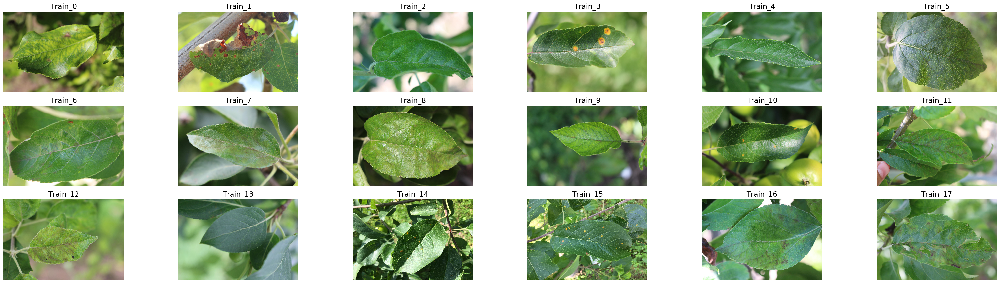

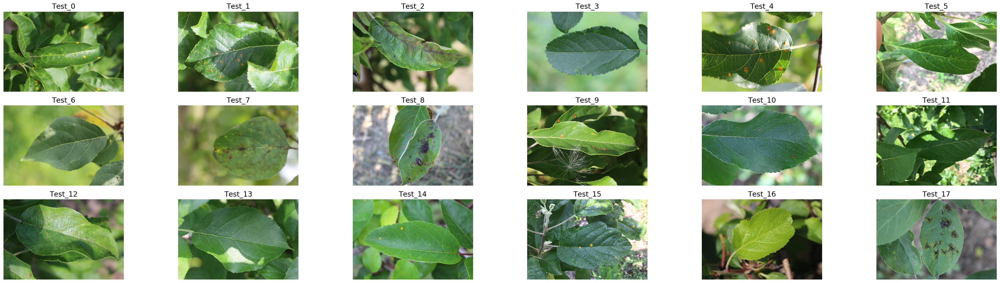

In [7]:
plot_all_example(df = df_train)
plot_all_example(df = df_test)

## Healthy

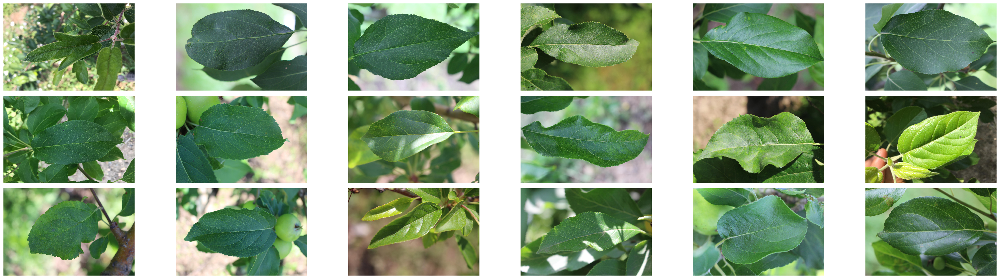

In [8]:
plot_class_example(df=df_train, label="healthy")

## Rust

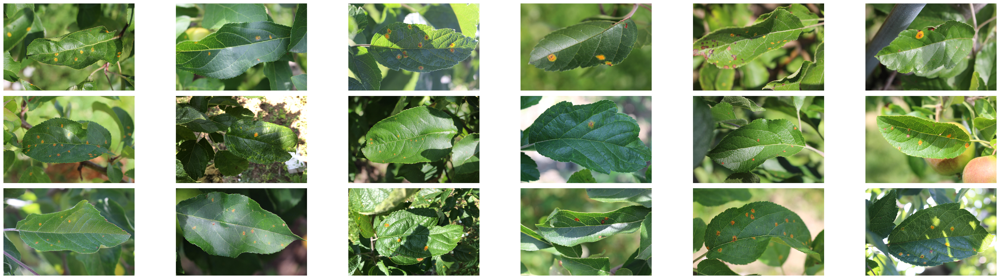

In [9]:
plot_class_example(df=df_train, label="rust")

## Scab

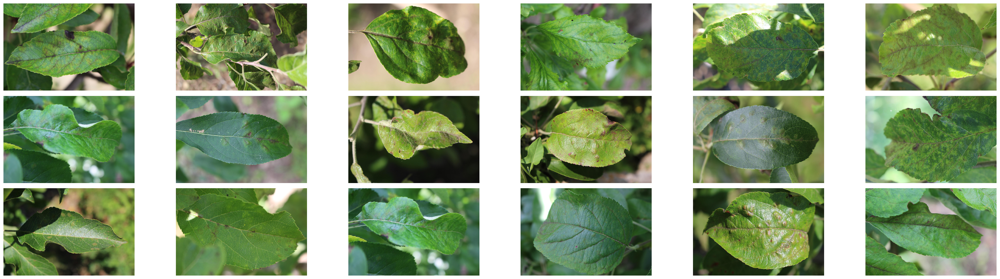

In [10]:
plot_class_example(df=df_train, label="scab")

## Multiple diseases

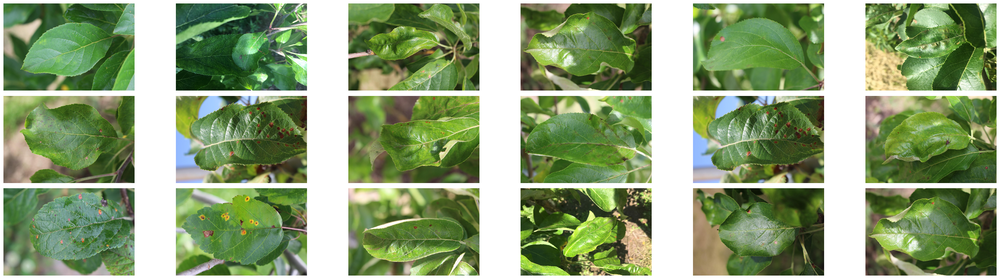

In [11]:
plot_class_example(df=df_train, label="multiple_diseases")

## Label distribution

healthy              516
multiple_diseases     91
rust                 622
scab                 592
dtype: int64


Text(0, 0.5, 'Sum')

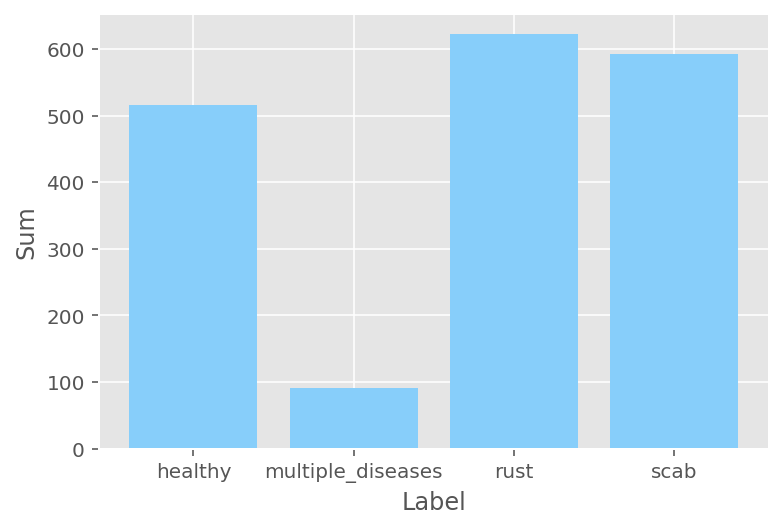

In [12]:
labels = ["healthy", "multiple_diseases", "rust", "scab"]
label_sum = df_train[labels].sum(axis=0)
print(label_sum)

plt.bar(labels, label_sum, color="#87CEFA")
plt.xlabel('Label'); plt.ylabel('Sum')

healthy              0.283361
multiple_diseases    0.049973
rust                 0.341571
scab                 0.325096
dtype: float64


Text(0, 0.5, 'Proportion')

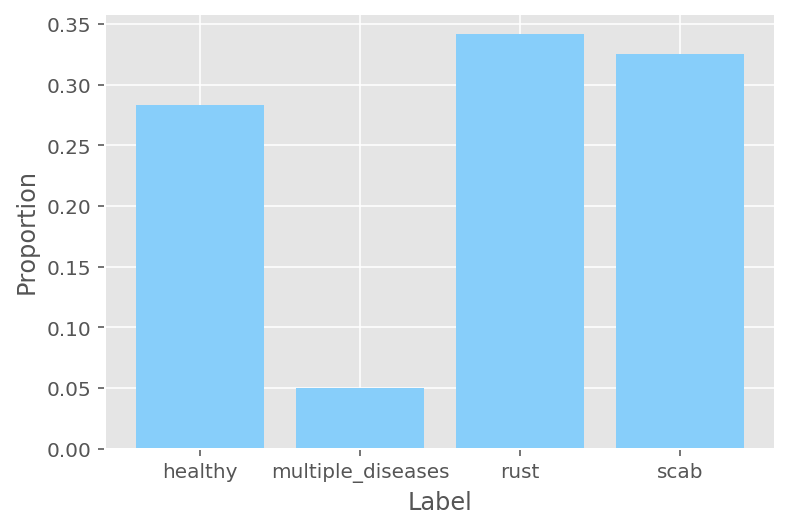

In [13]:
labels = ["healthy", "multiple_diseases", "rust", "scab"]
label_distribution = df_train[labels].sum(axis=0) / len(df_train)
print(label_distribution)

plt.bar(labels, label_distribution, color="#87CEFA")
plt.xlabel('Label'); plt.ylabel('Proportion')

# 2. RGB distribution histogram

## Healthy (RGB distribution of single image)

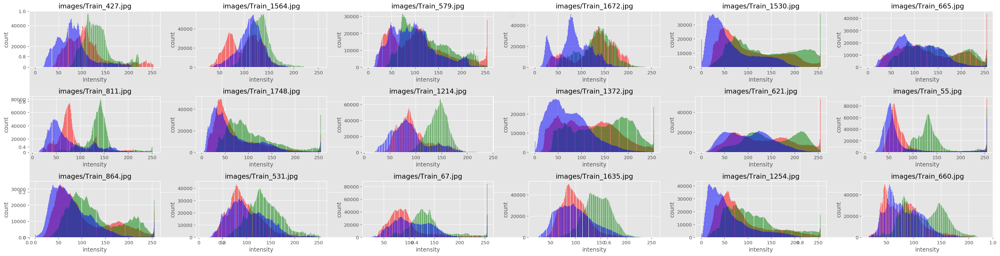

In [14]:
plot_color_hist(df_train, label="healthy")

## Rust (RGB distribution of single image)

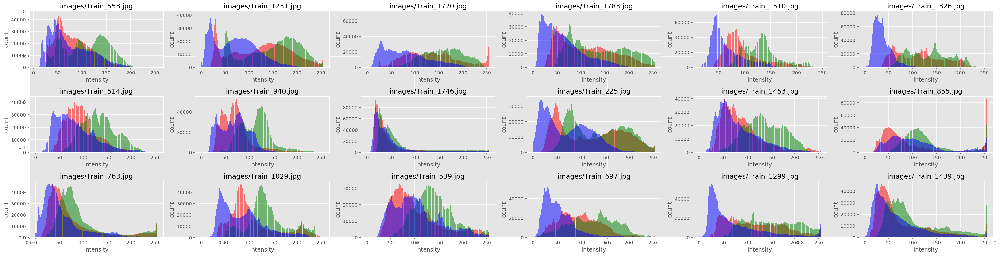

In [15]:
plot_color_hist(df_train, label="rust")

## Scab (RGB distribution of single image)

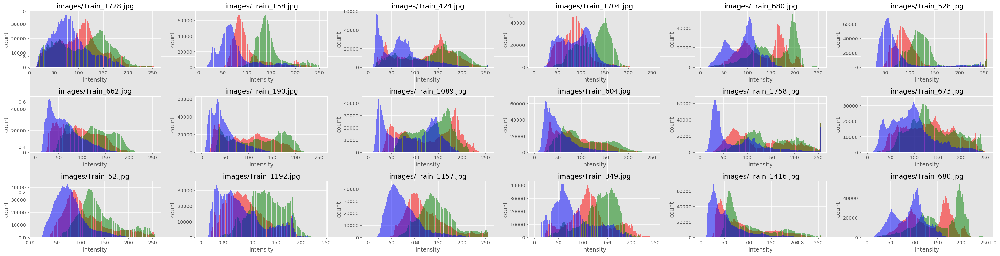

In [16]:
plot_color_hist(df_train, label="scab")

## Multiple diseases (RGB distribution of single image)

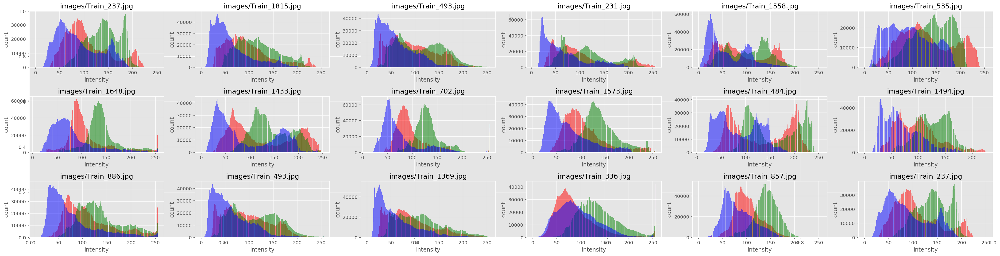

In [17]:
plot_color_hist(df_train, label="multiple_diseases")

## Healthy  (RGB distribution of all healthy images in trainset)

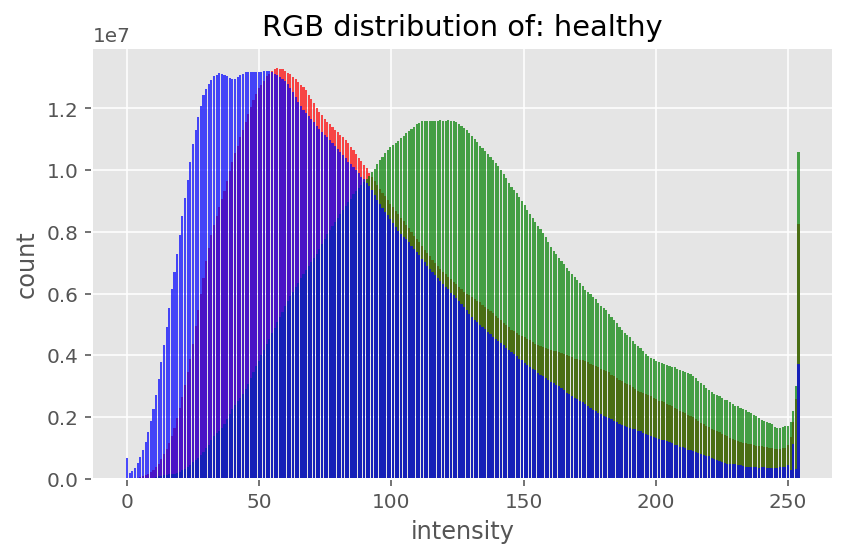

In [18]:
plot_sum_hist(df_train, "healthy")

## Rust (RGB distribution of all rust images in trainset)

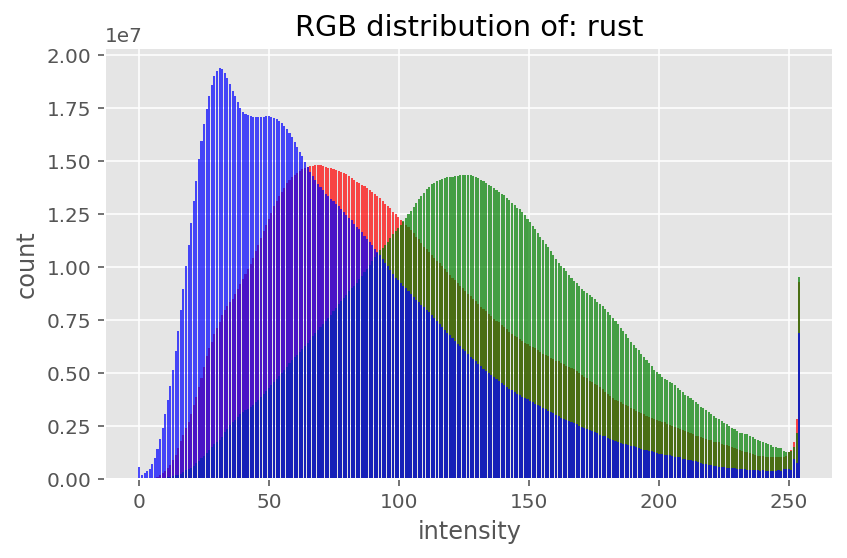

In [19]:
plot_sum_hist(df_train, "rust")

## Scab (RGB distribution of all scab images in trainset)

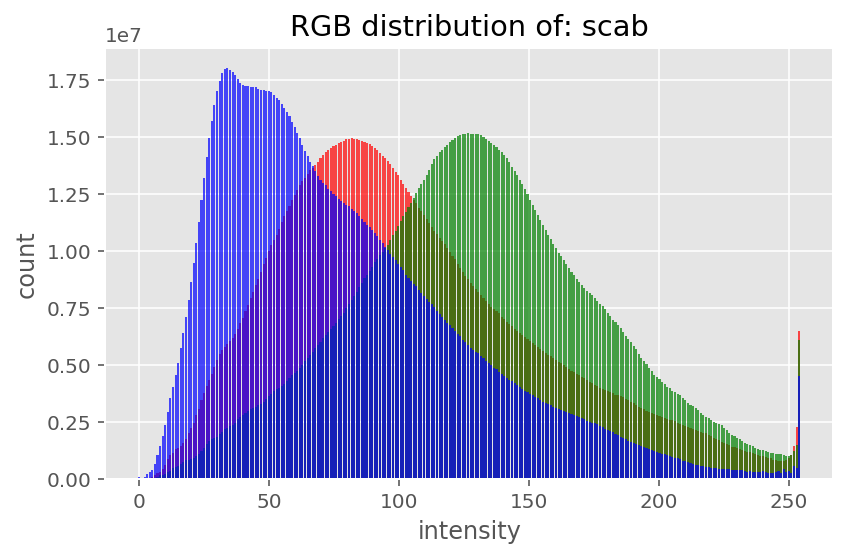

In [20]:
plot_sum_hist(df_train, "scab")

## Multiple diseases (RGB distribution of all multiple diseases images in trainset)

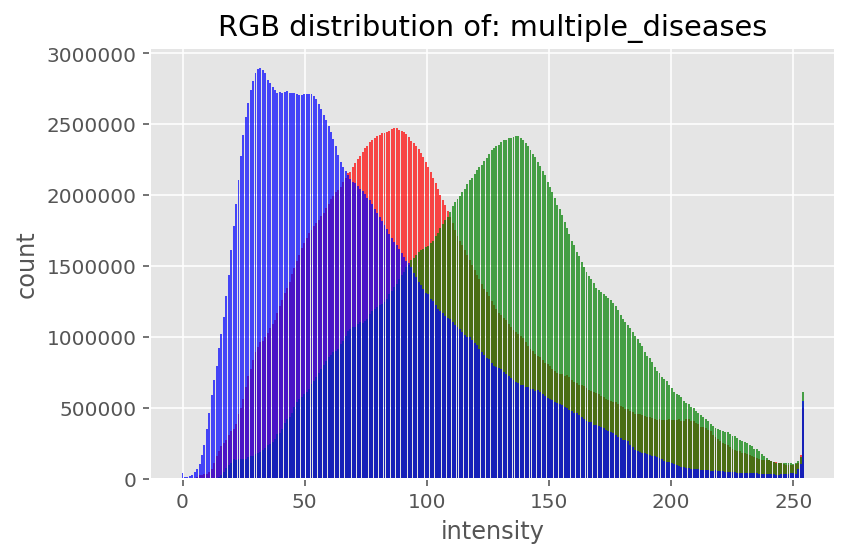

In [21]:
plot_sum_hist(df_train, "multiple_diseases")

# Part2. Baseline experiment

In [1]:
from sklearn.decomposition import PCA
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.feature_extraction.image import extract_patches_2d

from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.metrics import categorical_accuracy
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, LearningRateScheduler

/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:529: FutureWarning: Passi

## Helper Functions

# Part3. Advanced experiment

In [2]:
import os
import cv2
import math
import itertools
import albumentations as albu
from sklearn.utils import shuffle
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

## Helper function

In [3]:
def get_label(row_df):
    
    if row_df['multiple_diseases']:
        return 'multiple_diseases'
    
    if row_df['rust']:
        return 'rust'
    
    if row_df['scab']:
        return 'scab'
    
    if row_df['healthy']:
        return 'healthy'

In [7]:
# Function to show confusion matrix

def show_CM(TrueY, PredY):
    CM = confusion_matrix(TrueY, PredY)
    figsize=(4,4)
    fig = plt.figure(figsize=figsize)
    
    plt.imshow(CM, interpolation='nearest', cmap=plt.cm.Reds)
    plt.colorbar()

    tick_marks = np.arange(len(labels))
    plt.xticks(tick_marks, labels, rotation=45)
    plt.yticks(tick_marks, labels)
    plt.xlabel('Predict Label')
    plt.ylabel('True Label')

    thresh = CM.max() / 2.
    fmt = 'd'

    for i in range(len(labels)):
        for j in range(len(labels)):
            plt.text(j, i, format(CM[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if CM[i, j] > thresh else "black")

## Load data

In [8]:
df_train = pd.read_csv("./data/train.csv")
df_test = pd.read_csv("./data/test.csv")
df_sample = pd.read_csv("./data/sample_submission.csv")

df_train['target_label'] = df_train.apply(get_label, axis=1)
y = df_train['target_label']

print(df_train.shape)
print(df_test.shape)
print(df_sample.shape)
print(y.shape)

(1821, 6)
(1821, 1)
(1821, 5)
(1821,)


## Trainset split

In [9]:
# shuffle to provide randomness
df_train = shuffle(df_train)

# use stratify to preserve the original label distribution
df_split_train, df_split_val = train_test_split(df_train, test_size=0.2, random_state=0, stratify=y)

print(df_split_train.shape)
print(df_split_val.shape)

(1456, 6)
(365, 6)


## View split train set structure
Notice the unbalance lack of 'multiple_diseases' samples in trainset, we need to balance it later.

In [10]:
# Original trainset
df_train['target_label'].value_counts()

rust                 622
scab                 592
healthy              516
multiple_diseases     91
Name: target_label, dtype: int64

In [11]:
# the split trainset
df_split_train['target_label'].value_counts()

rust                 489
scab                 474
healthy              417
multiple_diseases     76
Name: target_label, dtype: int64

In [12]:
# the split validset
df_split_val['target_label'].value_counts()

rust                 133
scab                 118
healthy               99
multiple_diseases     15
Name: target_label, dtype: int64

## Image augmentation

In [13]:
# Function to do image augmentation
# params aug_type: augmentation operation type; img: image instance

def image_augmentation(aug_type, img):

    augmented_img =  aug_type(image=img)
    augmented_img = augmented_img['image']
    
    # type: np-array
    return augmented_img

In [14]:
# 3 sets of augmentation operation
# https://github.com/albumentations-team/albumentations

aug_types = albu.Compose([
    
    albu.HorizontalFlip(),
    albu.OneOf([albu.HorizontalFlip(),albu.VerticalFlip(),],p=0.8),
    albu.OneOf([albu.RandomContrast(), albu.RandomGamma(), albu.RandomBrightness(),], p=0.3),
    albu.OneOf([albu.ElasticTransform(alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                albu.GridDistortion(), albu.OpticalDistortion(distort_limit=2, shift_limit=0.5),],
                p=0.3),
    albu.ShiftScaleRotate()
])

aug_types2 = albu.Compose([
    albu.RandomRotate90(p=0.5),
    albu.HorizontalFlip(p=0.5),
    albu.RandomGamma(gamma_limit=(80, 120), p=0.5),
    albu.JpegCompression(quality_lower=70, quality_upper=90, p=0.5),
    albu.RandomScale(scale_limit=(0.5, 2), interpolation=cv2.INTER_CUBIC, p=1),
    albu.Resize(224,224,always_apply=True),],
    p=1)

aug_types3 = albu.Compose([
    albu.HorizontalFlip(), 
    albu.OneOf([albu.RandomContrast(), albu.RandomGamma(), albu.RandomBrightness(),], p=0.3),
    albu.OneOf([albu.ElasticTransform(alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                albu.GridDistortion(), albu.OpticalDistortion(distort_limit=2, shift_limit=0.5),], 
                p=0.3),
    albu.ShiftScaleRotate(),
    albu.Resize(224,224,always_apply=True),    # a square image
])

In [15]:
def plot_aug_example(path):
    
    figsize=(30,8)
    fig = plt.figure(figsize=figsize)
    
    fig.add_subplot(1, 4, 1)
    image = plt.imread(path)
    plt.axis('off')
    plt.title('original')
    plt.imshow(image)
    
    fig.add_subplot(1, 4, 2)
    aug_image = image_augmentation(aug_types, image)
    plt.axis('off')
    plt.title('aug_type1')
    plt.imshow(aug_image)
  
    fig.add_subplot(1, 4, 3)
    aug_image = image_augmentation(aug_types2, image)
    plt.axis('off')
    plt.title('aug_type2')
    plt.imshow(aug_image)
    
    fig.add_subplot(1, 4, 4)
    aug_image = image_augmentation(aug_types3, image)
    plt.axis('off')
    plt.title('aug_type3')
    plt.imshow(aug_image)

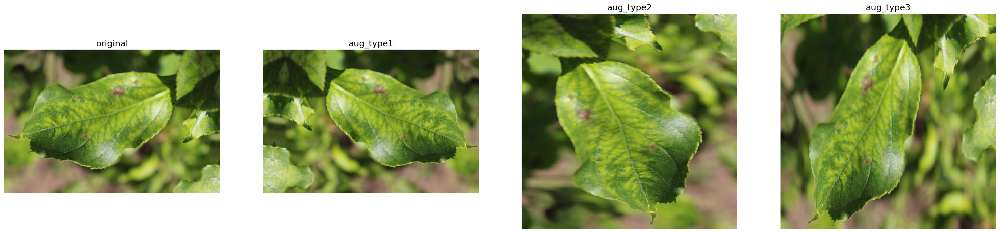

In [16]:
# Test the aug_types operation, change the value sample_path to check

sample_path = 'images/Train_0.jpg'
plot_aug_example(sample_path)

## Balance the split trainset
Here we manually increase 'multiple_diseases' samples'  frequency of occurrence

In [17]:
other_sample = df_split_train[df_split_train['target_label'] != 'multiple_diseases']
multi_sample = df_split_train[df_split_train['target_label'] == 'multiple_diseases']

# vertical concat with axis=0
df_split_train = pd.concat([df_split_train,
                            multi_sample,  multi_sample,
                            multi_sample,  multi_sample], axis=0)

# https://blog.csdn.net/dzysunshine/article/details/99082550
# reset index after concat, drop previous index
df_split_train = df_split_train.reset_index(drop=True)
df_split_train = shuffle(df_split_train)

df_split_train['target_label'].value_counts()
print(df_split_train.shape)

(1760, 6)


## Data Generator
Here, we use generator to prevent memory issue

In [18]:
# new csv file to hold the split trainset
df_test.to_csv('splitcsv/df_test_new.csv', index=False)
df_split_train.to_csv('splitcsv/df_train_new.csv', index=False)
df_split_val.to_csv('splitcsv/df_val_new.csv', index=False)

In [19]:
def data_generator(batch_size=8, df_path='splitcsv/df_train.csv', mode='non-test'):
    while True:
        if mode=='non-test':
            for df_row in pd.read_csv(df_path, chunksize=batch_size):
                img_id = list(df_row['image_id'])
            
                # X_gen=224*224*3
                X_gen = np.zeros((len(df_row), 224, 224, 3), dtype=np.uint8)

                for i in range(0, len(img_id)):
                    # Generate X
                    path = 'images/' + img_id[i] + '.jpg'
                    image = cv2.imread(path)
                
                    # Convert BGR to RGB, then resize
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                    image = cv2.resize(image, (224, 224))
                
                    # Generate Y
                    labels = ['healthy', 'multiple_diseases', 'rust', 'scab']
                    y_gen = df_row[labels]
                    y_gen = np.asarray(y_gen)
#                     print(y_gen)
                
                    # Augmentation
#                     aug_image = image_augmentation(aug_types, image)
#                     aug_image = image_augmentation(aug_types2, image)
                    aug_image = image_augmentation(aug_types3, image)
                    X_gen[i] = aug_image
                          
                # Normalization
                X_gen = X_gen/255
                yield X_gen, y_gen
                
        elif mode == 'test':
            for df_row in pd.read_csv(df_path, chunksize=batch_size):
                img_id = list(df_row['image_id'])
                    
                X_gen = np.zeros((len(df_row), 224, 224, 3), dtype=np.uint8)
        
                for i in range(0, len(img_id)):
                    path = 'images/' + img_id[i] + '.jpg'
                    image = cv2.imread(path)
                        
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                    image = cv2.resize(image, (224, 224))
                    X_gen[i] = image
                
                X_gen = X_gen/255
                yield X_gen

In [20]:
def test_generator(batch_size=1):
    while True:
        for df in pd.read_csv('df_test.csv.gz', chunksize=batch_size):
            image_id_list = list(df['image_id'])
            X_test = np.zeros((len(df), IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS), dtype=np.uint8)
            
            for i in range(0, len(image_id_list)):
                image_id = image_id_list[i] + '.jpg'
                path = 'images/' + image_id
                image = cv2.imread(path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, (IMAGE_HEIGHT, IMAGE_WIDTH))
                X_test[i] = image
                
            X_test = X_test/255

            yield X_test

(8, 224, 224, 3)
(8, 4)
[[0 0 1 0]
 [0 1 0 0]
 [0 0 1 0]
 [0 0 0 1]
 [0 0 1 0]
 [0 0 0 1]
 [0 0 1 0]
 [0 1 0 0]]


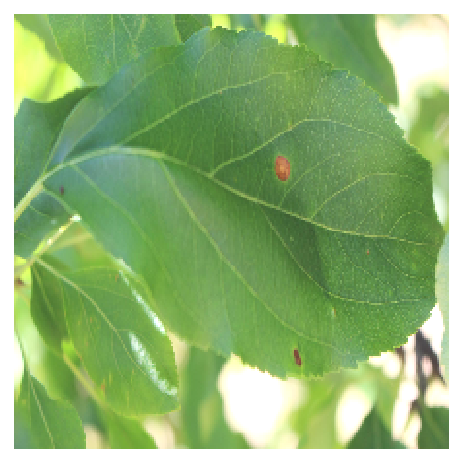

In [21]:
# Test data generator, it will return a data batch, output image should be augmented
train_batch = data_generator(batch_size=8, df_path='splitcsv/df_train_new.csv')
train_x_batch, train_y_batch = next(train_batch)

print(train_x_batch.shape)
print(train_y_batch.shape)
print(train_y_batch)

# output the first image in batch
image = train_x_batch[0,:,:,:]
plt.axis('off')
plt.imshow(image)


## Model (based on MobileNet)

In [22]:
path = 'mobilenet_1_0_224_tf.h5'
model = MobileNet(weights=path)

# Use the network except the last 2 layers as base model
x = model.layers[-2].output
# Add a new dense layer to the basic model, the number of prediction label:4
last_layer = Dense(4, activation='softmax')(x)

# inputs: output of basic model, outputs: dense layer, combine to form the new model
model = Model(inputs=model.input, outputs=last_layer)
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 225, 225, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseC

## Train Model

In [23]:
# import math
# TRAIN_BATCH_SIZE = 8
# VALID_BATCH_SIZE = 5

# num_train_samples = len(df_split_train)
# num_val_samples = len(df_split_val)

# # In one round, train all data
# train_steps = math.ceil(num_train_samples / TRAIN_BATCH_SIZE)
# val_steps = math.ceil(num_val_samples / VALID_BATCH_SIZE)

# # Initialize data generators
# train_gen = data_generator(batch_size=TRAIN_BATCH_SIZE, df_path ='splitcsv/df_train_new.csv')
# val_gen = data_generator(batch_size=VALID_BATCH_SIZE, df_path ='splitcsv/df_val_new.csv')

# model.compile(
#     Adam(lr=0.001),
#     loss='categorical_crossentropy',
#     metrics=['accuracy'])

# save_model_path = "saved_model/weights-saved-{epoch:02d}-{val_acc:.2f}.hdf5"

# early_stop = EarlyStopping(patience=10, verbose=1)

# checkpoint = ModelCheckpoint(save_model_path, monitor='val_accuracy', verbose=1, 
#                              save_best_only=True, mode='max')

# reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.3, patience=3, verbose=1, mode='max')

# log_fname = 'training_log.csv'
# csv_logger = CSVLogger(filename=log_fname, separator=',', append=False)

# callbacks_list = [checkpoint, csv_logger, reduce_lr, early_stop]

# history = model.fit_generator(train_gen, steps_per_epoch=train_steps, epochs=50, 
#                               validation_data=val_gen, validation_steps=val_steps,
#                               verbose=1, callbacks=callbacks_list)

# model.save("my_model.h5")

In [24]:
TRAIN_BATCH_SIZE = 8
VALID_BATCH_SIZE = 5

# Initialize the generators
train_gen = data_generator(batch_size=TRAIN_BATCH_SIZE, df_path ='splitcsv/df_train_new.csv')
val_gen = data_generator(batch_size=VALID_BATCH_SIZE, df_path ='splitcsv/df_val_new.csv')

train_steps = math.ceil( len(df_split_train) / TRAIN_BATCH_SIZE)
valid_steps = math.ceil( len(df_split_val) / VALID_BATCH_SIZE)

model.compile(
    Adam(lr=1e-3),
    loss='categorical_crossentropy',
    metrics=['accuracy'])

save_model_path = "saved_model/weights-saved-{epoch:02d}-{val_acc:.2f}.hdf5"

early_stop = EarlyStopping(patience=5, verbose=1)

checkpoint = ModelCheckpoint(save_model_path, monitor='val_acc', verbose=1, 
                             save_best_only=True, mode='max')

# Monitor the valid-accuracy
reduce_lr = ReduceLROnPlateau(monitor='val_acc', factor=0.3, patience=5, verbose=1, mode='max')

log_file = 'training_log.csv'
csv_log = CSVLogger(filename=log_file, separator=',', append=False)

callbacks_list = [checkpoint, csv_log, reduce_lr, early_stop]

history = model.fit_generator(generator=train_gen, epochs=50, validation_data=val_gen, 
                              steps_per_epoch=train_steps,validation_steps=valid_steps,
                              verbose=1, callbacks=callbacks_list)

model.save("my_model.h5")

Instructions for updating:
Use tf.cast instead.
Epoch 1/50
73/73 [==============================] - 20s 268ms/step - loss: 10.2995 - acc: 0.3507

Epoch 00001: val_acc improved from -inf to 0.35068, saving model to saved_model/weights-saved-01-0.35.hdf5
220/220 [==============================] - 381s 2s/step - loss: 9.5121 - acc: 0.3511 - val_loss: 10.2995 - val_acc: 0.3507
Epoch 2/50
73/73 [==============================] - 18s 241ms/step - loss: 6.6906 - acc: 0.3616

Epoch 00002: val_acc improved from 0.35068 to 0.36164, saving model to saved_model/weights-saved-02-0.36.hdf5
220/220 [==============================] - 362s 2s/step - loss: 4.5390 - acc: 0.3011 - val_loss: 6.6906 - val_acc: 0.3616
Epoch 3/50
73/73 [==============================] - 19s 257ms/step - loss: 10.9073 - acc: 0.3233

Epoch 00003: val_acc did not improve from 0.36164
220/220 [==============================] - 437s 2s/step - loss: 3.3004 - acc: 0.3455 - val_loss: 10.9073 - val_acc: 0.3233
Epoch 4/50
73/73 [======

## Training Logs & Curves

In [25]:
# Display Logs
logcsv = pd.read_csv(log_file)

# display all
logcsv.head(50)

,epoch,acc,loss,val_acc,val_loss
0,0,0.351136,9.512078,0.350685,10.299520
1,1,0.301136,4.538976,0.361644,6.690628
2,2,0.345455,3.300448,0.323288,10.907314
3,3,0.407955,1.478736,0.542466,1.005243
4,4,0.549432,1.111258,0.660274,0.997609
5,5,0.627841,0.915672,0.635616,0.913618
6,6,0.711932,0.738007,0.652055,0.902575
7,7,0.766477,0.627806,0.797260,0.588125
8,8,0.809659,0.493266,0.835616,0.539649
9,9,0.834091,0.444045,0.794521,0.623395


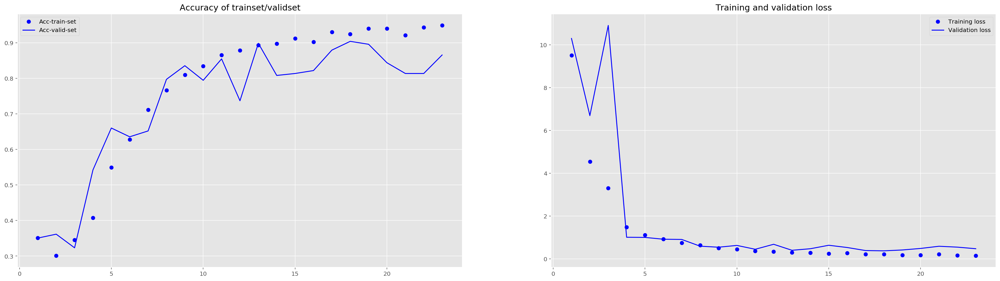

In [26]:
# Display curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

num_epoch = range(1, len(acc) + 1)
figsize=(30,8)
fig = plt.figure(figsize=figsize)

# Accuracy Curve
fig.add_subplot(1, 2, 1)
plt.plot(num_epoch, acc, 'bo', label='Acc-train-set')
plt.plot(num_epoch, val_acc, 'b', label='Acc-valid-set')
plt.title('Accuracy of trainset/validset')
plt.legend()

# Loss Curve
fig.add_subplot(1, 2, 2)
plt.plot(num_epoch, loss, 'bo', label='Training loss')
plt.plot(num_epoch, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

## Evaluation on validset: Overall Accuracy & Confusion Matrix & Report

In [27]:
# Overall accuracy on validset

model.load_weights('my_model.h5')

valid_generator = data_generator(batch_size=VALID_BATCH_SIZE, df_path='splitcsv/df_val_new.csv')
val_loss, val_acc = model.evaluate_generator(valid_generator, steps=valid_steps)

print('loss of valid set:', val_loss)
print('accuracy of valid set:', val_acc)


loss of valid set: 0.47915908973664045
accuracy of valid set: 0.84109586


365/365 [==============================] - 18s 50ms/step


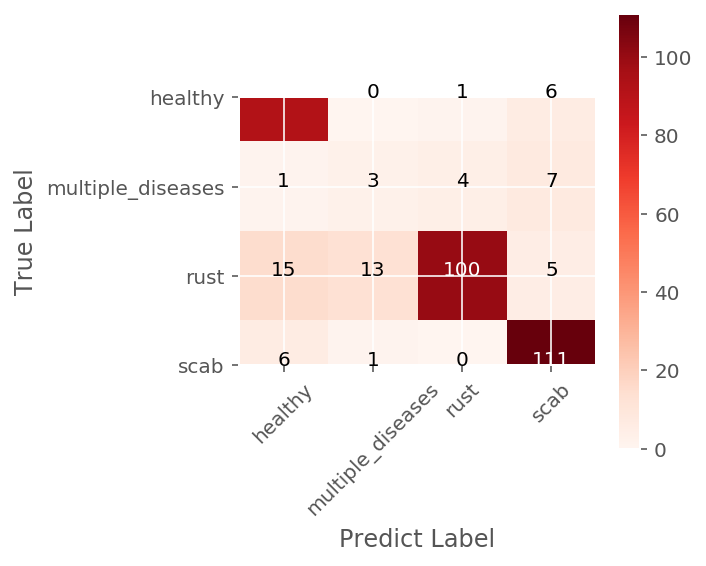

In [28]:
# Confusion Matrix
valid_generator = data_generator(batch_size=1, df_path='splitcsv/df_val_new.csv')
predY = model.predict_generator(valid_generator, steps=len(df_split_val), verbose=1)

# horizontal rgmax for prediction
PredY = np.argmax(predY, axis=1)

# transfer groundth truth y as array([3, 1, 0, ..., 0, 2, 3])
labels = ['healthy', 'multiple_diseases', 'rust', 'scab']
TrueY = np.argmax(np.asarray(df_split_val[labels]) , axis=1)

show_CM(TrueY=TrueY, PredY=PredY)

In [29]:
# Model SUmmary Report
report = classification_report(TrueY, PredY, target_names=labels)
print(report)

                   precision    recall  f1-score   support

          healthy       0.81      0.93      0.86        99
multiple_diseases       0.18      0.20      0.19        15
             rust       0.95      0.75      0.84       133
             scab       0.86      0.94      0.90       118

         accuracy                           0.84       365
        macro avg       0.70      0.71      0.70       365
     weighted avg       0.85      0.84      0.84       365



# Part3. Prediction: Testset

In [30]:
# Load model
model.load_weights('my_model.h5')

# Generator
test_gen = data_generator(batch_size=1, df_path='splitcsv/df_test_new.csv', mode='test')

preds = model.predict_generator(test_gen, steps=len(df_test), verbose=1)
# preds = model.predict_generator(test_gen, steps=len(df_split_val), verbose=1)

# Put the preds into a dataframe
df_preds = pd.DataFrame(preds, columns=['healthy', 'multiple_diseases', 'rust', 'scab'])

df_preds['image_id'] = df_test['image_id'].copy()
df_preds.head()



1821/1821 [==============================] - 91s 50ms/step


,healthy,multiple_diseases,rust,scab,image_id
0,0.095002,0.221649,6.661533e-01,0.017195,Test_0
1,0.057415,0.742846,5.530525e-02,0.144434,Test_1
2,0.000001,0.000029,8.474361e-07,0.999969,Test_2
3,0.997577,0.000040,1.222966e-03,0.001159,Test_3
4,0.002238,0.905764,8.657484e-02,0.005423,Test_4


In [31]:
# Create a submission csv file, acc = 0.937
df_results = pd.DataFrame({'image_id': df_preds.image_id,
                           'healthy': df_preds.healthy,
                           'multiple_diseases': df_preds.multiple_diseases,
                           'rust': df_preds.rust,
                           'scab': df_preds.scab
                          }).set_index('image_id')


# create a submission csv file
labels=['healthy', 'multiple_diseases', 'rust', 'scab']
df_results.to_csv('submission.csv', columns=labels) 